In [1]:
import trimesh

## 好像不能直接读取obj文件
显示：unable to load materials from: cantilever.mtl

In [2]:
mesh = trimesh.load_mesh("cantilever.obj")

unable to load materials from: cantilever.mtl


KeyboardInterrupt: 

In [3]:
# 转成 stl 之后可以
mesh = trimesh.load_mesh("cantilever.stl")

In [4]:
mesh.show()

In [5]:
# facets are groups of coplanar adjacent faces
# set each facet to a random color
# colors are 8 bit RGBA by default (n,4) np.uint8
for facet in mesh.facets:
    mesh.visual.face_colors[facet] = trimesh.visual.random_color()

In [6]:
# transform method can be passed a (4,4) matrix and will cleanly apply the transform
mesh.apply_transform(trimesh.transformations.random_rotation_matrix())

<trimesh.Trimesh(vertices.shape=(464258, 3), faces.shape=(925106, 3))>

In [7]:
# an axis aligned bounding box is available
mesh.bounding_box.primitive.extents

TrackedArray([ 7.06086667, 16.63372333, 36.29269752])

In [8]:
# a minimum volume oriented bounding box is available
mesh.bounding_box_oriented.primitive.extents

TrackedArray([ 0.86542676,  1.64280929, 39.84130293])

In [9]:
mesh.bounding_box_oriented.primitive.transform

TrackedArray([[-0.65629869, -0.74155278,  0.13918154,  5.36412408],
              [ 0.723208  , -0.56570731,  0.39616338, -1.11257111],
              [-0.21504005,  0.36065871,  0.90756987, -1.94866735],
              [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [10]:
# the bounding box is a trimesh.primitives.Box object, which subclasses
# Trimesh and lazily evaluates to fill in vertices and faces when requested
mesh.bounding_box_oriented.show()

In [11]:
# get a single cross section of the mesh
slice = mesh.section(plane_origin=mesh.centroid, 
                     plane_normal=[0,0,1])

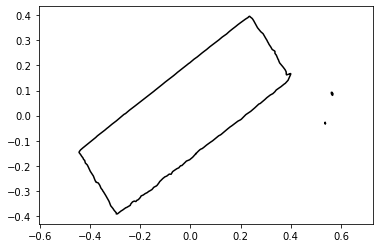

In [13]:
# we can move the 3D curve to a Path2D object easily
slice_2D, to_3D = slice.to_planar()
slice_2D.show()

In [14]:
slice_2D.area

0.26191611347427585